In [1]:
from google.colab import drive
drive.mount('/content/drive', force_remount=True)

Mounted at /content/drive


In [24]:
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from matplotlib import pyplot as plt
import numpy as np
def aumentarImagenes(img_array,n,plotear=False):
  img_array = np.expand_dims(img_array,axis=0)

  datagen = ImageDataGenerator(
      rotation_range=40,
      width_shift_range=0.2,
      height_shift_range=0.2,
      shear_range=0.2,
      zoom_range=0.2,
      horizontal_flip=True,
      fill_mode='nearest'
  )
  i = 0
  images = []
  for batch in datagen.flow(img_array, batch_size=1):
    if plotear:
      plt.figure(i)
      plt.imshow(batch[0])
    images.append(batch[0])
    i += 1
    if i >= n:
        break
  if plotear:
    plt.show()
  return images

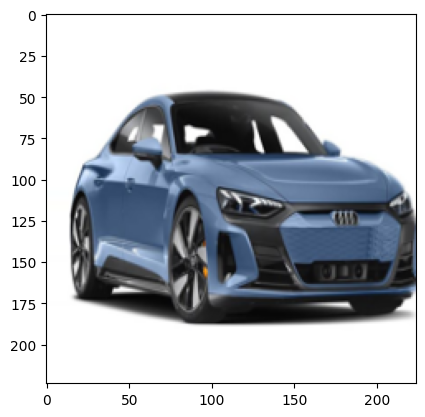

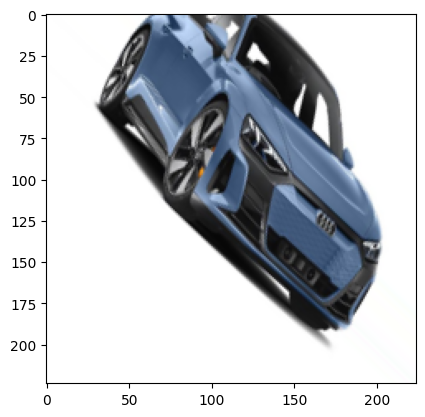

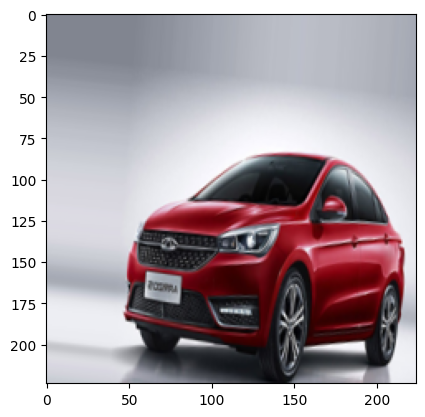

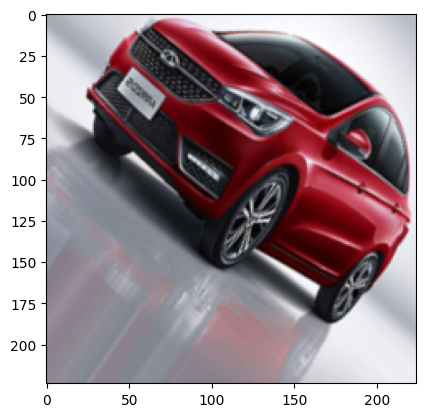

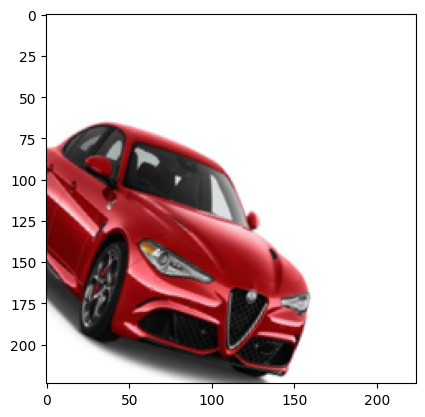

...

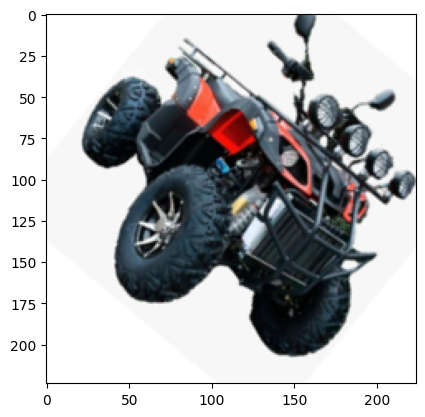

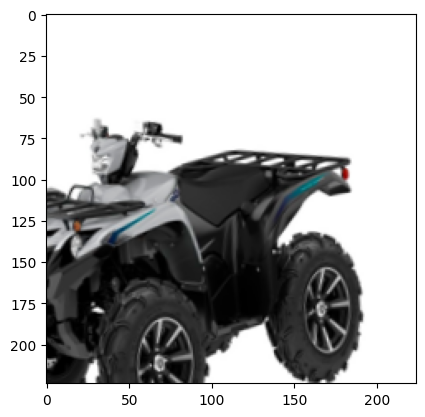

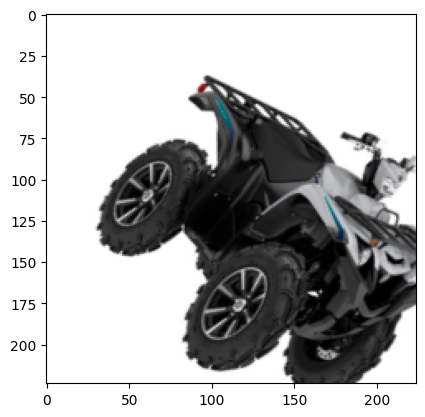

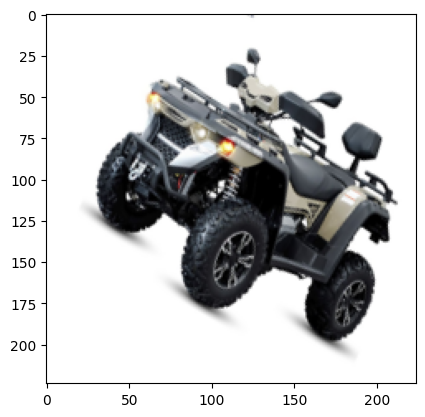

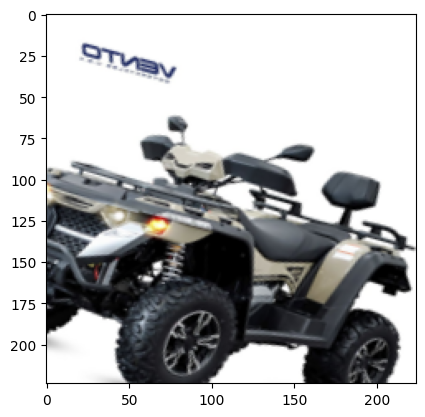

300


{0: 60, 1: 60, 2: 60, 3: 60, 4: 60}

In [25]:
#Carga de librerias
from PIL import Image
import os
import numpy as np
import cv2
# Ruta a la carpeta que contiene las imágenes
folder_path = '/content/drive/My Drive/EntrenamientoIA/Todo'

# Lista para almacenar las imágenes cargadas
image_list = []
#Lista para almacenar las etiquetas
y = []
# Recorre todos los archivos en la carpeta
val = -1
for filename in os.listdir(folder_path):
    if 'Auto' in filename:
      y.append(0) #indice 0 Auto [Auto,Camion,Moto,Cuatrimoto,Camioneta]
      val = 0
    elif 'Camion' in filename: #indice 1 Camion
      y.append(1)
      val = 1
    elif 'Moto' in filename: #indice 2 Moto
      y.append(2)
      val = 2
    elif 'Cuatrimoto' in filename: #indice 3 Cuatrimoto
      y.append(3)
      val = 3
    elif 'Neta' in filename: #indice 4 Camioneta
      y.append(4)
      val = 4

    if filename.endswith(".jpg") or filename.endswith(".png") or filename.endswith(".jpeg"):
        img_path = os.path.join(folder_path, filename)
        img = Image.open(img_path)
        img = img.resize((224, 224))  # Redimensiona la imagen


        img_array = np.array(img) / 255.0  # Normaliza los valores de píxeles

        image_list.append(img_array)
        aumentadas = aumentarImagenes(img_array,2,True)
        image_list.extend(aumentadas)
        for i in range(len(aumentadas)):
          y.append(val)

y2=y
y2.sort()
print(len(y2))
#Ordenamos la lista, ademas de mostrar la cantidad total y cuantos de cada etiqueta hay
dict(zip(y2,map(lambda x: y2.count(x),y2)))

# Ahora 'image_list_train' contiene todas las imágenes cargadas

In [ ]:
#img_array
image_list

[array([[[1., 1., 1.],
         [1., 1., 1.],
         [1., 1., 1.],
         ...,
         [1., 1., 1.],
         [1., 1., 1.],
         [1., 1., 1.]],
 
        [[1., 1., 1.],
         [1., 1., 1.],
         [1., 1., 1.],
         ...,
         [1., 1., 1.],
         [1., 1., 1.],
         [1., 1., 1.]],
 
        [[1., 1., 1.],
         [1., 1., 1.],
         [1., 1., 1.],
         ...,
         [1., 1., 1.],
         [1., 1., 1.],
         [1., 1., 1.]],
 
        ...,
 
        [[1., 1., 1.],
         [1., 1., 1.],
         [1., 1., 1.],
         ...,
         [1., 1., 1.],
         [1., 1., 1.],
         [1., 1., 1.]],
 
        [[1., 1., 1.],
         [1., 1., 1.],
         [1., 1., 1.],
         ...,
         [1., 1., 1.],
         [1., 1., 1.],
         [1., 1., 1.]],
 
        [[1., 1., 1.],
         [1., 1., 1.],
         [1., 1., 1.],
         ...,
         [1., 1., 1.],
         [1., 1., 1.],
         [1., 1., 1.]]]),
 array([[[0.61176471, 0.62745098, 0.67058824],
        

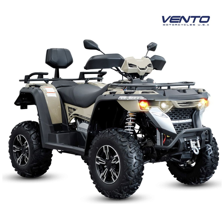

In [ ]:
img

In [26]:
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(image_list, y, test_size=0.2, random_state=42, stratify=y)

In [27]:
import pandas as pd
from sklearn.metrics import confusion_matrix, accuracy_score, precision_score, recall_score, f1_score, roc_auc_score, mean_absolute_error, mean_squared_error, r2_score
from sklearn.metrics import ConfusionMatrixDisplay
def metricas(y_real, y_pred,labels):
  #y_pred = np.argmax(y_pred, axis=1)
  # Accuracy
  # Métricas de clasificación
  conf_matrix = confusion_matrix(y_test, y_pred)
  accuracy = accuracy_score(y_test, y_pred)

  # Calculamos precision, recall y f1 para cada clase
  precision = precision_score(y_test, y_pred, average=None)
  precision_avg = precision_score(y_test, y_pred, average="macro")
  recall = recall_score(y_test, y_pred, average=None)
  recall_avg = recall_score(y_test, y_pred, average="macro")
  f1 = f1_score(y_test, y_pred, average=None)
  f1_avg = f1_score(y_test, y_pred, average="macro")
  print("Exactitud:", accuracy)
  print("Precisión por clase:", precision,'->', precision_avg)
  print("Sensibilidad por clase:", recall,'->', recall_avg)
  print("F1 Score por clase:", f1,'->', f1_avg)

  cm = confusion_matrix(y_test, y_pred)
  disp = ConfusionMatrixDisplay(confusion_matrix=cm)
  disp.display_labels = ['Auto','Camion','Moto','Cuatrimoto','Camioneta']
  disp.plot()

Modelo1

Fold 1 - Accuracy: 0.3542
Fold 2 - Accuracy: 0.9583
Fold 3 - Accuracy: 0.9167
Fold 4 - Accuracy: 0.9792
Fold 5 - Accuracy: 0.7708
Average Accuracy: 0.7958
Epoch 1/200
3/3 ━━━━━━━━━━━━━━━━━━━━ 1s 238ms/step - accuracy: 0.9454 - loss: 0.1073
Epoch 2/200
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step - accuracy: 0.9638 - loss: 0.0987 
Epoch 3/200
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step - accuracy: 0.9554 - loss: 0.1037 
Epoch 4/200
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step - accuracy: 0.9763 - loss: 0.0746 
Epoch 5/200
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step - accuracy: 0.9771 - loss: 0.0595 
Epoch 6/200
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step - accuracy: 0.9817 - loss: 0.0506 
Epoch 7/200
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step - accuracy: 0.9817 - loss: 0.0497 
Epoch 8/200
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step - accuracy: 0.9883 - loss: 0.0438 
Epoch 9/200
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step - accuracy: 0.9883 - loss: 0.0406 
Epoch 10/200
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step - accuracy: 0.9883 - loss: 0.

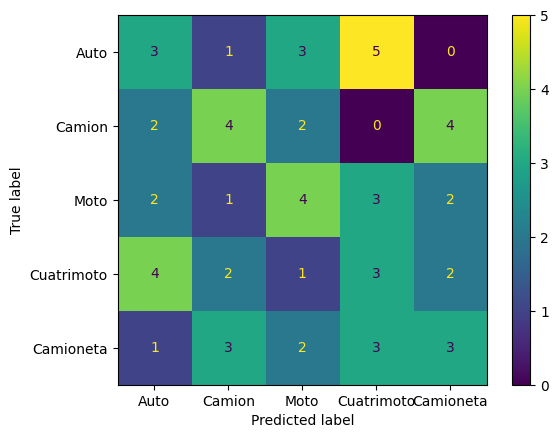

In [28]:
import tensorflow as tf
from tensorflow import keras
import numpy as np
from sklearn.model_selection import KFold
from sklearn.model_selection import train_test_split
from tensorflow.keras.callbacks import ModelCheckpoint
keras.utils.set_random_seed(42)
np.random.seed(42)

model1 = keras.Sequential([
    keras.Input(shape=(224, 224, 3)),
    keras.layers.Flatten(),
    keras.layers.Dense(128, activation='relu'),
    keras.layers.Dense(64, activation='relu'),
    keras.layers.Dense(5, activation='softmax'),

])


model1.compile(optimizer='adam',
              loss='sparse_categorical_crossentropy',
              metrics=['accuracy'])
model1.save_weights('model1.weights.h5')
checkpoint = ModelCheckpoint('best_model.keras', monitor='val_loss', save_best_only=True, mode='min')

kf = KFold(n_splits=5, shuffle=True, random_state=42)
fold_no=1
accuracies=[]
X_train = np.array(X_train)
y_train = np.array(y_train)
for train_index, val_index in kf.split(X_train):
    X_train_fold, X_val_fold = X_train[train_index], X_train[val_index]
    y_train_fold, y_val_fold = y_train[train_index], y_train[val_index]
    model = model1
    history = model.fit(X_train_fold, y_train_fold, epochs=50, batch_size=32,verbose=0, validation_data=(X_val_fold, y_val_fold), callbacks=[checkpoint])
    loss,accuracy = model.evaluate(X_val_fold, y_val_fold, verbose=0)
    accuracies.append(accuracy)
    print(f"Fold {fold_no} - Accuracy: {accuracy:.4f}")
    fold_no+=1
print(f"Average Accuracy: {np.mean(accuracies):.4f}")
X_test = np.array(X_test)
y_test = np.array(y_test)
model1.fit(np.array(X_train),np.array(y_train), epochs=200, batch_size=100)
y_pred = model1.predict(X_test)
y_pred = np.argmax(np.round(y_pred), axis=1)
metricas(y_test,y_pred,['Auto','Camion','Moto','Cuatrimoto','Camioneta'])

In [29]:
model2 = keras.models.load_model('best_model.keras')

In [30]:
model2.summary()

Model: "sequential_3"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ flatten_3 (Flatten)                  │ (None, 150528)              │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_9 (Dense)                      │ (None, 128)                 │      19,267,712 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_10 (Dense)                     │ (None, 64)                  │           8,256 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_11 (Dense)                     │ (None, 5)                   │             325 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 57,828,881 (220.60 MB)

 Trainable params: 19,276,293 (73.53 MB)

 Non-trainable params: 0 (0.00 B)

 Optimizer params: 38,552,588 (147.07 MB)

In [31]:
model.summary()

Model: "sequential_3"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ flatten_3 (Flatten)                  │ (None, 150528)              │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_9 (Dense)                      │ (None, 128)                 │      19,267,712 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_10 (Dense)                     │ (None, 64)                  │           8,256 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_11 (Dense)                     │ (None, 5)                   │             325 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 57,828,881 (220.60 MB)

 Trainable params: 19,276,293 (73.53 MB)

 Non-trainable params: 0 (0.00 B)

 Optimizer params: 38,552,588 (147.07 MB)

In [32]:
!pip install tf2onnx

In [35]:
!pip install --upgrade tensorflow  # Upgrade to the latest stable TensorFlow release
!pip install --upgrade tf2onnx  # Upgrade to the latest stable tf2onnx release

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 615.3/615.3 MB 816.1 kB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 5.5/5.5 MB 9.2 MB/s eta 0:00:00
  Attempting uninstall: tensorboard
    Found existing installation: tensorboard 2.17.1
    Uninstalling tensorboard-2.17.1:
      Successfully uninstalled tensorboard-2.17.1
  Attempting uninstall: tensorflow
    Found existing installation: tensorflow 2.17.1
    Uninstalling tensorflow-2.17.1:
      Successfully uninstalled tensorflow-2.17.1
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
tf-keras 2.17.0 requires tensorflow<2.18,>=2.17, but you have tensorflow 2.18.0 which is incompatible.


In [3]:
import tensorflow as tf
import tf2onnx
import onnx

# Load the Keras model
modelEx = tf.keras.models.load_model('best_model.keras')

# Set the output names (if necessary)
modelEx.output_names = ['output']

# Specify input signature explicitly
# Assume input shape is (None, 224, 224, 3) - adjust if needed
input_signature = [tf.TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32)]

# Convert to ONNX using the input signature
onnx_model, _ = tf2onnx.convert.from_keras(modelEx, input_signature=input_signature, opset=13)

# Save the ONNX model
onnx.save(onnx_model, 'modelo.onnx')

In [4]:
import tensorflow as tf
from tensorflow.keras.models import load_model

keras_model = load_model('best_model.keras')
converter = tf.lite.TFLiteConverter.from_keras_model(keras_model)
tflite_model = converter.convert()
with open('modelo.tflite', 'wb') as f:
    f.write(tflite_model)

Saved artifact at '/tmp/tmpxxxby7v8'. The following endpoints are available:

* Endpoint 'serve'
  args_0 (POSITIONAL_ONLY): TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name='input_layer_3')
Output Type:
  TensorSpec(shape=(None, 5), dtype=tf.float32, name=None)
Captures:
  140646758316896: TensorSpec(shape=(), dtype=tf.resource, name=None)
  140646759191248: TensorSpec(shape=(), dtype=tf.resource, name=None)
  140648844895584: TensorSpec(shape=(), dtype=tf.resource, name=None)
  140646759201984: TensorSpec(shape=(), dtype=tf.resource, name=None)
  140646759200048: TensorSpec(shape=(), dtype=tf.resource, name=None)
  140646630567152: TensorSpec(shape=(), dtype=tf.resource, name=None)
